In [14]:
import numpy as np
from astropy.table import Table,Column
from astropy.io import fits
import matplotlib.pyplot as plt
import bz2
import pdb
import warnings
import os.path
%matplotlib inline
from matplotlib.colors import LogNorm
import matplotlib.gridspec as gridspec
from astropy import wcs


In [3]:
#data = Table.read('/home/mel/Documents/GZ_HUBBLE/gzh_red_disks/new_ferengi/data/ferengi_candidates_1527.fits')
data = Table.read('example_galaxies.fits') #2nd run - already have list of galaxies


In [4]:
def field_name(r,c,f,bnd):
    fname = '../ugriz_bulk_images/frame-'+bnd+'-'+'{:06d}'.format(r)+'-'+'{:1d}'.format(c)+'-'+'{:04d}'.format(f)+'.fits.bz2'
    return fname
def psf_name(r,c,f):
    fname = '../psField_files/psField-'+'{:06d}'.format(r)+'-'+'{:1d}'.format(c)+'-'+'{:04d}'.format(f)+'.fit'
    return fname
def tsf_name(r,c,f):
    fname = '../tsField_files/tsField-'+'{:06d}'.format(r)+'-'+'{:1d}'.format(c)+'-'+'40-'+'{:04d}'.format(f)+'.fit'
    return fname

In [108]:
#First - get list of galaxies that are on edge of field - too lazy to splice together!! 

edge_galaxy_objids = []
for gal in data:
        objid = gal['dr12objid']
        f = gal['field']
        c = gal['camcol']
        r = gal['run']

        rad = gal['petror90_r']/0.396 #[pixels] #set sized based on r band radius
        row = gal['rowc_r'] # r row coordinate
        col = gal['colc_r'] # r column coordinate
        
        r_name = field_name(r,c,f,'r') #check r band tile
        r_hdulist=fits.open(hdu_fieldname)
        hdr = r_hdulist[0].header

        extents = [int(row-3*rad), int(row+3*rad), int(col-3*rad), int(col+3*rad)] 

        if (extents[1] > hdr['NAXIS2']) or (extents[3] > hdr['NAXIS1']) or all(i > 0 for i in extents)==False: #galaxy on edge - add to bad list
            edge_galaxy_objids.append(objid)


In [6]:
idx=0
bands = ['u','g','r','i','z']

hdulists={}
while len(hdulists)<20:
    gal = data[idx]
    objid = gal['dr12objid']
    f = gal['field']
    c = gal['camcol']
    r = gal['run']

    #need to make sure files exist... not all downloaded correctly
    if os.path.isfile(field_name(r,c,f,'u'))==True and os.path.isfile(psf_name(r,c,f))==True and os.path.isfile(tsf_name(r,c,f))==True: # and objid not in edge_galaxy_objids:
        #if all are True - have all the data for each     
        
        hdulists[objid]={}
        for band in bands:
            hdu_fieldname = field_name(r,c,f,band)
            hdulists[objid][band]= fits.open(hdu_fieldname)
            
        hdu_psfname = psf_name(r,c,f)
        hdulists[objid]['psf']= fits.open(hdu_psfname)
        hdu_tsfname = tsf_name(r,c,f)
        hdulists[objid]['tsf']= fits.open(hdu_tsfname)
    else: #not enough data, move on
        pass
    idx += 1

#convert units 
for objid in hdulists:
    for band in bands:
        conversion_factor = 1./hdulists[objid][band][0].header['NMGY']
        hdulists[objid][band][0].data=hdulists[objid][band][0].data*conversion_factor

# Old Cutout method (potential alignment issues):

In [22]:
def makecutouts(objid):
    cutouts={}
    bands = ['u','g','r','i','z']
    gal = data[data['dr12objid']==objid]
    for band in bands:
        
        hdulist = hdulists[objid][band]
    
        img = hdulist[0].data
        hdr = hdulist[0].header
    
        rad = gal['petror90_r']/0.396 #[pixels] #set sized based on r band radius
        row = gal['rowc_r'] # r row coordinate
        col = gal['colc_r'] # r column coordinate
    
        #size = 3*radius
        extents = [int(row-3*rad), int(row+3*rad), int(col-3*rad), int(col+3*rad)] 

        # otherwise, create the stamp!
        cutout = img[extents[0]:extents[1], extents[2]:extents[3]]
            # if size*Rp doesn't work, default is 3*Rp 

        # convert the array into a FITS image
        cutouts[band] = fits.ImageHDU(data=cutout, header=hdr)

    return cutouts

In [147]:
cutout_images = {}
for objid in hdulists:
    cutout_images[objid]={}
    cutout_images[objid] = makecutouts(objid)

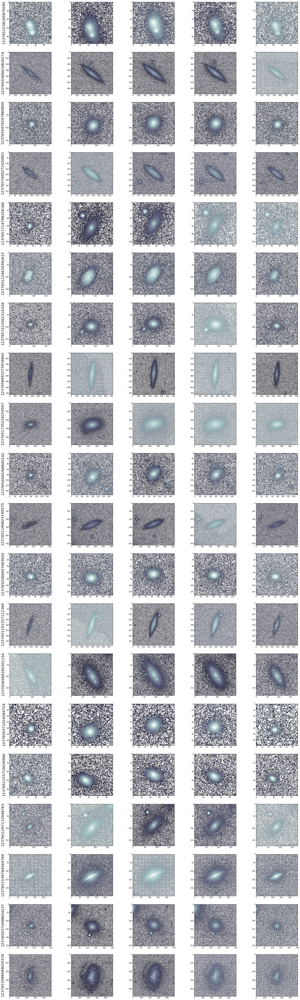

In [154]:
f = plt.figure(figsize=(30,100))
gs = gridspec.GridSpec(20,5)

row_i=np.linspace(0,19,20)
col_i = np.linspace(0,4,5)

for row in row_i:
    row = int(row)
    objid = cutout_images.keys()[row]
    this_cutout = cutout_images[objid]
    for col in col_i:
        col = int(col)
        ax = plt.subplot(gs[row,col])
        plt.imshow(this_cutout[bands[col]].data,cmap=plt.cm.bone,norm=LogNorm())
        if col==0:
            plt.ylabel('{:d}'.format(objid),fontsize=20)
        


# New Cutout Method (thanks Melanie!!):

In [25]:
def makecutouts(objid):
    cutouts={}
    bands = ['u','g','r','i','z']
    gal = data[data['dr12objid']==objid]
    ra = gal['RA']
    dec = gal['DEC']
    for band in bands:
        
        hdulist = hdulists[objid][band]
    
        img = hdulist[0].data
        hdr = hdulist[0].header

        #new coordinates:
        w = wcs.WCS(hdulist[0].header)
        pix = w.wcs_world2pix(ra, dec,1)
        row, col = int(pix[1]), int(pix[0])

        rad = gal['petror90_r']/0.396 #[pixels] #set sized based on r band radius

        #size = 3*radius
        extents = [int(row-3*rad), int(row+3*rad), int(col-3*rad), int(col+3*rad)] 

    
        # otherwise, create the stamp!
        cutout = img[extents[0]:extents[1], extents[2]:extents[3]]
            # if size*Rp doesn't work, default is 3*Rp 

        # convert the array into a FITS image
        cutouts[band] = fits.ImageHDU(data=cutout, header=hdr)

    return cutouts

In [26]:
cutout_images = {}
for objid in hdulists:
    cutout_images[objid]={}
    cutout_images[objid] = makecutouts(objid)

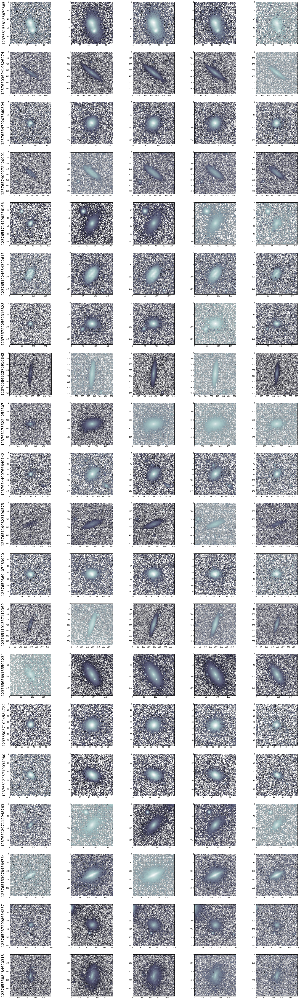

In [27]:
f = plt.figure(figsize=(30,100))
gs = gridspec.GridSpec(20,5)

row_i=np.linspace(0,19,20)
col_i = np.linspace(0,4,5)

for row in row_i:
    row = int(row)
    objid = cutout_images.keys()[row]
    this_cutout = cutout_images[objid]
    for col in col_i:
        col = int(col)
        ax = plt.subplot(gs[row,col])
        plt.imshow(this_cutout[bands[col]].data,cmap=plt.cm.bone,norm=LogNorm())
        if col==0:
            plt.ylabel('{:d}'.format(objid),fontsize=20)
        


## Write fits cutouts, psf, and tsf files for each galaxy

In [155]:
for objid in cutout_images:
    for band in bands:
        name = 'ugriz_cutouts/{:d}_{:s}.fits'.format(objid,band)
        cutout_images[objid][band].writeto(name,clobber=True)


In [174]:
for objid in hdulists:
    psf_name = 'psf_files/{:d}_psf.fits'.format(objid,band)
    hdulists[objid]['psf'].writeto(psf_name,clobber=True)

    tsf_name = 'tsf_files/{:d}_tsf.fits'.format(objid,band)
    hdulists[objid]['tsf'].writeto(tsf_name,clobber=True)


## create table of 20 test galaxies with objid, row and col info for ferengifying. 

In [219]:
c1 = Column([key for key in hdulists],name='dr12objid')
rowc_r = []
colc_r = []
redshifts=[]
for objid in c1:
    this_gal = data[data['dr12objid']==objid]
    row = this_gal['rowc_r']
    col = this_gal['colc_r']
    z=this_gal['redshift']
    rowc_r.append(row)
    colc_r.append(col)
    redshifts.append(z)
    
c2 = Column(rowc_r,name='rowc_r')
c3 = Column(colc_r,name='colc_r')
c4 = Column(redshifts,name='redshift')

ex_table = Table()
ex_table.add_columns([c1,c2,c3,c4])

In [220]:
ex_table

dr12objid,rowc_r [1],colc_r [1],redshift [1]
int64,float64,float64,float64
1237651538185879585,247.5342,1326.476,0.01118355
1237650369410826274,396.3123,1017.41,0.006685563
1237655470207860804,1078.446,1925.221,0.0054969
1237657400272420901,342.6672,1368.966,0.008867319
1237651714798256166,265.1957,1953.797,0.008180379
1237651224634392615,376.5901,435.2833,0.0125006
1237657222562316328,507.6877,836.5369,0.007245984
1237658492275916842,1123.867,761.9695,0.005684192
1237651735224254507,869.9685,372.0122,0.006157753


In [221]:
ex_table.write('example_galaxies.fits',overwrite=True)

In [222]:
new_data = Table.read('example_galaxies.fits')

In [223]:
new_data

dr12objid,rowc_r,colc_r,redshift
int64,float64,float64,float64
1237651538185879585,247.5342,1326.476,0.01118355
1237650369410826274,396.3123,1017.41,0.006685563
1237655470207860804,1078.446,1925.221,0.0054969
1237657400272420901,342.6672,1368.966,0.008867319
1237651714798256166,265.1957,1953.797,0.008180379
1237651224634392615,376.5901,435.2833,0.0125006
1237657222562316328,507.6877,836.5369,0.007245984
1237658492275916842,1123.867,761.9695,0.005684192
1237651735224254507,869.9685,372.0122,0.006157753
